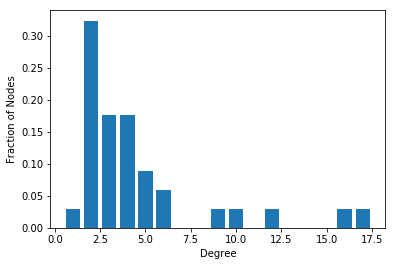

In [1]:
# degree distribution
# P(k) - 
import networkx as nx

G = nx.karate_club_graph()

degrees = G.degree()

degree_values = sorted(set(degrees.values()))

histogram = [list(degrees.values()).count(i)/float(nx.number_of_nodes(G)) for i in degree_values]

import matplotlib.pyplot as plt
plt.bar(degree_values,histogram)
plt.xlabel('Degree')
plt.ylabel('Fraction of Nodes')
plt.show()

In [ ]:
# directed graphs -> in-degree

in_degrees = G.in_degree()
#otherwise same same

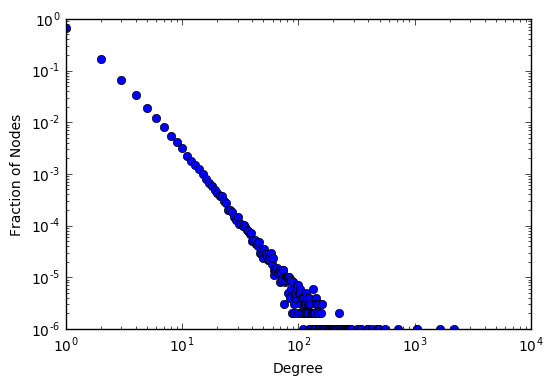

In [7]:
# Preferential Attachment Model  --> leads to Power Law Distributions
G = nx.barabasi_albert_graph(1000000,1)  # n - nodes, m - new nodes attach to m nodes

degrees = G.degree()

degree_values = sorted(set(degrees.values()))

histogram = [list(degrees.values()).count(i)/float(nx.number_of_nodes(G)) for i in degree_values]

import matplotlib.pyplot as plt
plt.plot(degree_values,histogram,'o')
plt.xlabel('Degree')
plt.ylabel('Fraction of Nodes')
plt.xscale('log')
plt.yscale('log')
plt.show()



In [2]:
G = nx.barabasi_albert_graph(1000,4)
print(nx.average_clustering(G))

0.03832632878888758


In [3]:
print(nx.average_shortest_path_length(G))

3.16594994994995


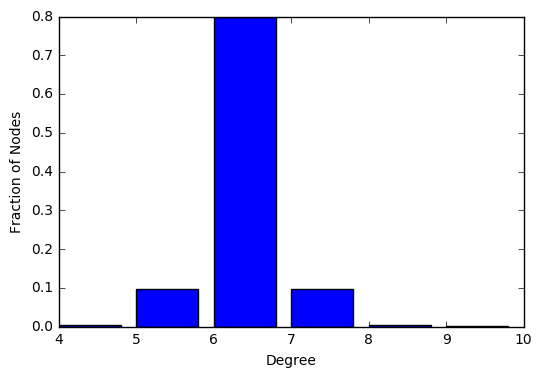

In [5]:
# small world models
H = nx.watts_strogatz_graph(1000,6,0.04)
# also nx.connected_watts_strogatz_graph with 4th param t - retries until connected
# also nx.newman_watts_strogatz_graph, not rewiring, but adding by p


degrees = H.degree()

degree_values = sorted(set(degrees.values()))

histogram = [list(degrees.values()).count(i)/float(nx.number_of_nodes(H)) for i in degree_values]

import matplotlib.pyplot as plt
plt.bar(degree_values,histogram)
plt.xlabel('Degree')
plt.ylabel('Fraction of Nodes')
plt.show()

In [6]:
# link prediction - common neighbours
common_neigh = [(e[0],e[1],len(list(nx.common_neighbors(G,e[0],e[1])))) for e in nx.non_edges(G)]

In [11]:
import operator
common_neigh=sorted(common_neigh,key=operator.itemgetter(2),reverse=True)
print(common_neigh)

[(5, 9, 17), (4, 21, 12), (5, 34, 11), (4, 10, 10), (4, 13, 10), (5, 12, 10), (5, 40, 10), (1, 13, 9), (5, 29, 9), (1, 3, 8), (4, 20, 8), (4, 24, 8), (4, 28, 8), (4, 76, 7), (5, 17, 7), (5, 18, 7), (5, 69, 7), (7, 21, 7), (9, 17, 7), (10, 33, 7), (0, 3, 6), (1, 7, 6), (1, 15, 6), (4, 8, 6), (4, 22, 6), (4, 33, 6), (4, 52, 6), (4, 59, 6), (4, 165, 6), (5, 41, 6), (5, 60, 6), (5, 86, 6), (5, 117, 6), (5, 144, 6), (5, 159, 6), (8, 13, 6), (9, 11, 6), (9, 33, 6), (13, 15, 6), (13, 28, 6), (13, 60, 6), (20, 28, 6), (26, 54, 6), (0, 11, 5), (1, 28, 5), (1, 43, 5), (2, 5, 5), (2, 28, 5), (3, 7, 5), (3, 9, 5), (3, 20, 5), (3, 58, 5), (4, 31, 5), (4, 38, 5), (4, 44, 5), (4, 101, 5), (4, 102, 5), (4, 137, 5), (4, 154, 5), (4, 346, 5), (5, 25, 5), (5, 43, 5), (5, 50, 5), (5, 59, 5), (5, 62, 5), (5, 71, 5), (5, 72, 5), (5, 78, 5), (5, 81, 5), (5, 82, 5), (5, 87, 5), (5, 91, 5), (5, 93, 5), (5, 109, 5), (5, 120, 5), (5, 222, 5), (6, 20, 5), (6, 87, 5), (7, 10, 5), (7, 13, 5), (7, 14, 5), (7, 15, 5)

In [12]:
# link pred - jaccard coefficent 
# common neighbours / total of neighbours

L = list(nx.jaccard_coefficient(G))
L.sort(key=operator.itemgetter(2),reverse=True)
print(L)


[(252, 397, 0.6), (655, 786, 0.5), (784, 940, 0.5), (198, 868, 0.375), (66, 561, 0.3333333333333333), (66, 905, 0.3333333333333333), (219, 988, 0.3333333333333333), (252, 321, 0.3333333333333333), (321, 397, 0.3333333333333333), (342, 803, 0.3333333333333333), (385, 900, 0.3333333333333333), (387, 574, 0.3333333333333333), (414, 955, 0.3333333333333333), (525, 983, 0.3333333333333333), (526, 642, 0.3333333333333333), (526, 732, 0.3333333333333333), (526, 946, 0.3333333333333333), (528, 636, 0.3333333333333333), (540, 946, 0.3333333333333333), (561, 637, 0.3333333333333333), (561, 905, 0.3333333333333333), (573, 916, 0.3333333333333333), (636, 781, 0.3333333333333333), (636, 917, 0.3333333333333333), (655, 795, 0.3333333333333333), (663, 980, 0.3333333333333333), (702, 931, 0.3333333333333333), (705, 943, 0.3333333333333333), (732, 946, 0.3333333333333333), (797, 908, 0.3333333333333333), (869, 950, 0.3333333333333333), (876, 984, 0.3333333333333333), (934, 949, 0.3333333333333333), (19

In [13]:
# resource allocation
# resource to node, distribution to neighbours -> sum(1/degree) for all common neighbours
L = list(nx.resource_allocation_index(G))
L.sort(key=operator.itemgetter(2),reverse=True)
print(L)

[(5, 9, 1.1853167073940687), (4, 21, 1.0198042465899608), (5, 34, 1.0042002529592198), (1, 13, 0.9901575044432187), (5, 86, 0.8878156565656565), (4, 10, 0.8704795854629741), (13, 60, 0.861904761904762), (5, 29, 0.8376533565330435), (10, 33, 0.7976146869004013), (4, 13, 0.7754444397301541), (5, 91, 0.764102564102564), (4, 59, 0.759148434148434), (1, 3, 0.7355677230241691), (10, 99, 0.7122222222222223), (4, 76, 0.7056218291512408), (5, 72, 0.69239417989418), (1, 43, 0.6867015098722415), (5, 69, 0.6799206349206349), (4, 346, 0.6721611721611722), (26, 54, 0.6702899452463913), (4, 20, 0.662441526727241), (5, 40, 0.6570071889751111), (4, 52, 0.6560451453308597), (5, 12, 0.641510509375347), (13, 15, 0.6285975928833072), (9, 33, 0.6248473748473748), (4, 44, 0.6146853146853146), (9, 315, 0.6069444444444444), (20, 243, 0.6065124489037532), (4, 24, 0.5973175614484769), (10, 34, 0.5838235294117647), (5, 60, 0.5823870573870573), (5, 82, 0.5765854521857118), (29, 479, 0.5714285714285714), (11, 40, 0

In [ ]:
# Adamic-Adar Index
# same as resource allocation but with 1/log(degree)
L = list(nx.adamic_adar_index(G))
L.sort(key=operator.itemgetter(2),reverse=True)
print(L)

In [14]:
# preferential attachment index
# product of degree of both nodes

L = list(nx.preferential_attachment(G))
L.sort(key=operator.itemgetter(2),reverse=True)
print(L)

[(5, 9, 10878), (4, 13, 8241), (4, 10, 6888), (5, 17, 6615), (5, 29, 6174), (4, 20, 6150), (4, 28, 5166), (5, 40, 5145), (5, 72, 4998), (4, 21, 4920), (5, 34, 4851), (5, 77, 4851), (4, 33, 4551), (4, 72, 4182), (4, 77, 4059), (4, 8, 3936), (9, 15, 3848), (5, 31, 3822), (5, 60, 3822), (3, 9, 3774), (10, 13, 3752), (9, 20, 3700), (7, 13, 3685), (5, 76, 3675), (5, 62, 3528), (5, 73, 3528), (5, 74, 3528), (13, 15, 3484), (3, 13, 3417), (9, 17, 3330), (4, 68, 3321), (2, 5, 3234), (5, 36, 3234), (5, 141, 3234), (4, 24, 3198), (4, 31, 3198), (4, 60, 3198), (9, 29, 3108), (5, 12, 3087), (5, 59, 3087), (5, 65, 3087), (5, 69, 3087), (5, 127, 3087), (7, 10, 3080), (4, 16, 3075), (4, 76, 3075), (13, 17, 3015), (4, 52, 2952), (4, 62, 2952), (4, 73, 2952), (4, 74, 2952), (5, 89, 2940), (5, 93, 2940), (1, 13, 2881), (7, 15, 2860), (3, 10, 2856), (4, 27, 2829), (13, 28, 2814), (3, 7, 2805), (10, 20, 2800), (5, 58, 2793), (7, 20, 2750), (9, 33, 2738), (4, 36, 2706), (4, 67, 2706), (4, 96, 2706), (4, 14

In [ ]:
# community structure
# number of common community neighbours - Common Neighbour Soundarajan-Hopcroft
# bonus points if neighbours in same community

#first assign communities
G.node['A']['community']=0
G.node['B']['community']=0
G.node['C']['community']=0
G.node['D']['community']=0
G.node['E']['community']=1
G.node['F']['community']=1
G.node['G']['community']=1
G.node['H']['community']=1

L = list(nx.cn_soundarajan_hopcroft(G))

L.sort(key=operator.itemgetter(2),reverse=True)
print(L)

In [ ]:
# Community Resouce Allocation - Resource Allocation Soundarajan Hopcroft score

L = list(nx.ra_index_soundarajan_hopcroft(G))

L.sort(key=operator.itemgetter(2),reverse=True)
print(L)